# Loading Prerequisites

In [1]:
# Install updated version of pandas_profiling.
#!pip install pandas_profiling==3.3.0

In [2]:
## Importing python packages

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil

from itertools import product
from pandas_profiling import ProfileReport

In [3]:
## Some configuration

%matplotlib inline

# for better resolution plots
%config InlineBackend.figure_format = 'retina'

# Set seaborn style
sns.set()

# Loading Data

In [5]:
## Load csv file into a dataframe 
data_path = "https://raw.githubusercontent.com/fpontejos/DMDM_2223/main/data/datamining.csv"

df = pd.read_csv(data_path)

In [35]:
## OR 
## to load from csv on your Google Drive

## Allow Colab to see Google Drive files

## Uncomment these two lines:

#from google.colab import drive
#drive.mount('/content/drive')


## Load csv file into a dataframe 
#data_path = "/content/drive/MyDrive/DMDM_Practical/data/datamining.csv"
#df = pd.read_csv(data_path)

## Refer to slides [Extra Content]

## Metadata
- *id* - The unique identifier of the customer
- *age* - The year of birht of the customer
- *income* - The income of the customer
- *frq* - Frequency: number of purchases made by the customer
- *rcn* - Recency: number of days since last customer purchase
- *mnt* - Monetary: amount of € spent by the customer in purchases
- *clothes* - Number of clothes items purchased by the customer
- *kitchen* - Number of kitchen items purchased by the customer
- *small_appliances* - Number of small_appliances items purchased by the customer
- *toys* - Number of toys items purchased by the customer
- *house_keeping* - Number of house_keeping items purchased by the customer
- *dependents* - Binary. Whether or not the customer has dependents
- *per_net_purchase* - Percentage of purchases made online
- *education* - Education level of the customer
- *status* - Marital status of the customer
- *gender* - Gender of the customer
- *description* - Last customer's recommendation description

# Initial Analysis

In [6]:
## Look at the first 10 rows of the data
df.head(10)

,age,income,frq,rcn,mnt,clothes,kitchen,small_appliances,toys,house_keeping,dependents,per_net_purchase,gender,education,status,description
0,1946,90782.0,33,66,1402,37,5,44,10,3,0.0,19,M,Graduation,Together,Take my money!!
1,1936,113023.0,32,6,1537,55,1,38,4,2,0.0,9,F,PhD,Divorced,Take my money!!
2,1990,28344.0,11,69,44,32,19,24,1,24,1.0,59,M,Graduation,Married,Kind of OK
3,1955,93571.0,26,10,888,60,10,19,6,5,1.0,35,F,Master,NaN,OK nice!
4,1955,91852.0,31,26,1138,59,5,28,4,4,1.0,34,F,Graduation,Together,Take my money!!
5,1982,22386.0,14,65,56,47,2,48,2,1,1.0,67,M,PhD,Single,OK nice!
6,1969,69485.0,18,73,345,71,7,13,1,8,1.0,46,M,Graduation,Together,OK nice!
7,1960,68602.0,5,44,41,84,1,12,2,0,1.0,37,M,Graduation,Together,Horrible
8,1940,109499.0,30,75,1401,38,9,35,9,9,0.0,17,M,Graduation,Divorced,OK nice!
9,1994,23846.0,8,153,19,18,55,17,10,1,1.0,39,F,1st Cycle,Together,Meh...


In [7]:
## Look at dataset data types
df.dtypes

age                   int64
income              float64
frq                   int64
rcn                   int64
mnt                   int64
clothes               int64
kitchen               int64
small_appliances      int64
toys                  int64
house_keeping         int64
dependents          float64
per_net_purchase      int64
gender               object
education            object
status               object
description          object
dtype: object

In [8]:
## Count of missing values
df.isna().sum()

age                   0
income               46
frq                   0
rcn                   0
mnt                   0
clothes               0
kitchen               0
small_appliances      0
toys                  0
house_keeping         0
dependents          282
per_net_purchase      0
gender                0
education            47
status              177
description           0
dtype: int64

In [9]:
## Check for duplicate rows
df.duplicated().sum()

0

In [10]:
## Check descriptive statistics: Numeric features only
df.describe().T 

,count,mean,std,min,25%,50%,75%,max
age,8998.0,1966.059680,17.296552,1936.0,1951.0,1966.0,1981.0,1996.0
income,8952.0,69963.550827,27591.556226,10000.0,47741.0,70030.5,92218.0,140628.0
frq,8998.0,19.848077,10.903435,3.0,10.0,17.0,28.0,59.0
rcn,8998.0,62.469771,69.761802,0.0,26.0,53.0,79.0,549.0
mnt,8998.0,622.162814,646.768205,6.0,63.0,383.0,1076.0,3052.0
clothes,8998.0,50.446655,23.422249,1.0,33.0,51.0,69.0,99.0
kitchen,8998.0,7.039675,7.848139,0.0,2.0,4.0,10.0,75.0
small_appliances,8998.0,28.524116,12.586437,1.0,19.0,28.0,37.0,74.0
toys,8998.0,7.036897,7.924422,0.0,2.0,4.0,10.0,62.0
house_keeping,8998.0,6.929984,7.882655,0.0,2.0,4.0,9.0,77.0


In [11]:
## Check descriptive statistics: All features
df.describe(include="all").T 

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
age,8998.0,NaN,NaN,NaN,1966.05968,17.296552,1936.0,1951.0,1966.0,1981.0,1996.0
income,8952.0,NaN,NaN,NaN,69963.550827,27591.556226,10000.0,47741.0,70030.5,92218.0,140628.0
frq,8998.0,NaN,NaN,NaN,19.848077,10.903435,3.0,10.0,17.0,28.0,59.0
rcn,8998.0,NaN,NaN,NaN,62.469771,69.761802,0.0,26.0,53.0,79.0,549.0
mnt,8998.0,NaN,NaN,NaN,622.162814,646.768205,6.0,63.0,383.0,1076.0,3052.0
clothes,8998.0,NaN,NaN,NaN,50.446655,23.422249,1.0,33.0,51.0,69.0,99.0
kitchen,8998.0,NaN,NaN,NaN,7.039675,7.848139,0.0,2.0,4.0,10.0,75.0
small_appliances,8998.0,NaN,NaN,NaN,28.524116,12.586437,1.0,19.0,28.0,37.0,74.0
toys,8998.0,NaN,NaN,NaN,7.036897,7.924422,0.0,2.0,4.0,10.0,62.0
house_keeping,8998.0,NaN,NaN,NaN,6.929984,7.882655,0.0,2.0,4.0,9.0,77.0


In [12]:
## Get unique values in a column
df['education'].unique()

array(['Graduation', 'PhD', 'Master', '1st Cycle', '2nd Cycle',
       'OldSchool', nan], dtype=object)

In [13]:
## Fix wrong data types
df.dependents = df.dependents.astype("boolean")

In [14]:
## TIP
# Different ways to access a column

df['age']
df.age
df.loc[:,'age']

0       1946
1       1936
2       1990
3       1955
4       1955
        ... 
8993    1960
8994    1975
8995    1986
8996    1938
8997    1994
Name: age, Length: 8998, dtype: int64

In [15]:
# Split features into metric/numeric vs non-metric/non-numeric

non_metric_features = ["education", "status", "gender", "dependents", "description"]
metric_features = df.columns.drop(non_metric_features).to_list()


# Visual Exploration

Matplotlib tutorials: https://matplotlib.org/3.3.1/tutorials/index.html

Matplotlib gallery: https://matplotlib.org/3.3.1/tutorials/introductory/sample_plots.html#sphx-glr-tutorials-introductory-sample-plots-py

Seaborn tutorials: https://seaborn.pydata.org/tutorial.html


Seaborn gallery: https://seaborn.pydata.org/examples/index.html

**More examples for visualizing distributions:**
- http://seaborn.pydata.org/tutorial/distributions.html

## Pyplot-style vs Object-Oriented-style
- Explicitly create figures and axes, and call methods on them (the "object-oriented (OO) style").
- Rely on pyplot to automatically create and manage the figures and axes, and use pyplot functions for plotting.

## Univariate Distribution

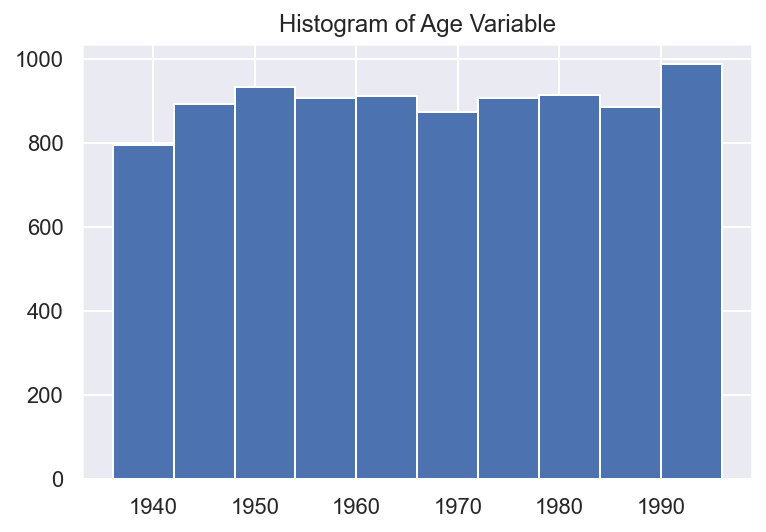

In [16]:
# Single Metric Variable Histogram
plt.hist(df["age"], bins=10)  # mess around with the bins
plt.title("Histogram of Age Variable")

plt.show()

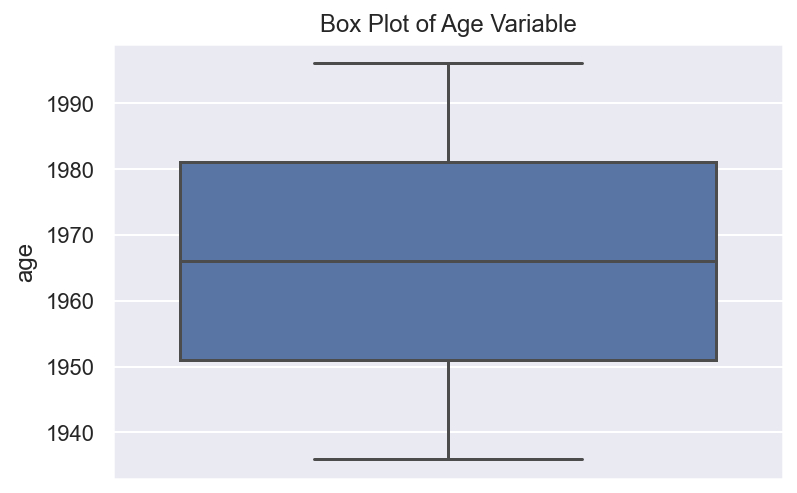

In [17]:
# Single Metric Variable Box Plot
sns.boxplot(y=df["age"])
plt.title("Box Plot of Age Variable")

plt.show()

In [18]:
## Define a function that plots multiple histograms

def plot_multiple_histograms(data, feats, title="Numeric Variables' Histograms"):

    # Prepare figure. Create individual axes where each histogram will be placed
    fig, axes = plt.subplots(2, ceil(len(feats) / 2), figsize=(20, 11))

    # Plot data
    # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
    for ax, feat in zip(axes.flatten(), feats): # Notice the zip() function and flatten() method
      ax.hist(data[feat])
      ax.set_title(feat)

    # Layout
    # Add a centered title to the figure:
    plt.suptitle(title)

    plt.show()

    return


## Define a function that plots multiple box plots

def plot_multiple_boxplots(data, feats, title="Numeric Variables' Box Plots"):

    # Prepare figure. Create individual axes where each histogram will be placed
    fig, axes = plt.subplots(2, ceil(len(feats) / 2), figsize=(20, 11))

    # Plot data
    # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
    for ax, feat in zip(axes.flatten(), feats): # Notice the zip() function and flatten() method
      sns.boxplot(x=data[feat], ax=ax)
      ax.set_title(feat)

    # Layout
    # Add a centered title to the figure:
    plt.suptitle(title)

    plt.show()

    return




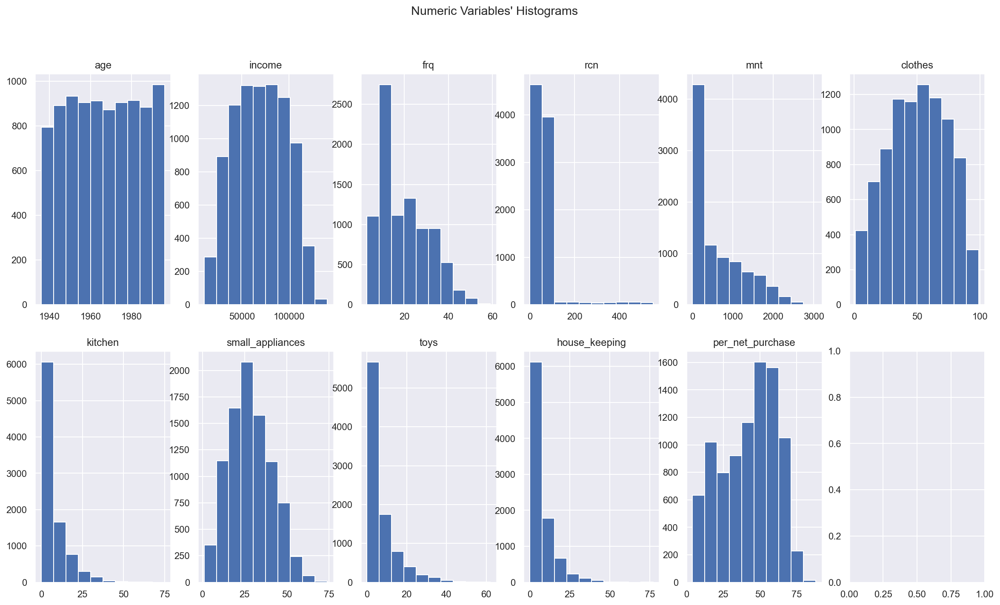

In [19]:
# All Numeric Variables' Histograms in one figure
sns.set()

plot_multiple_histograms(df, metric_features)



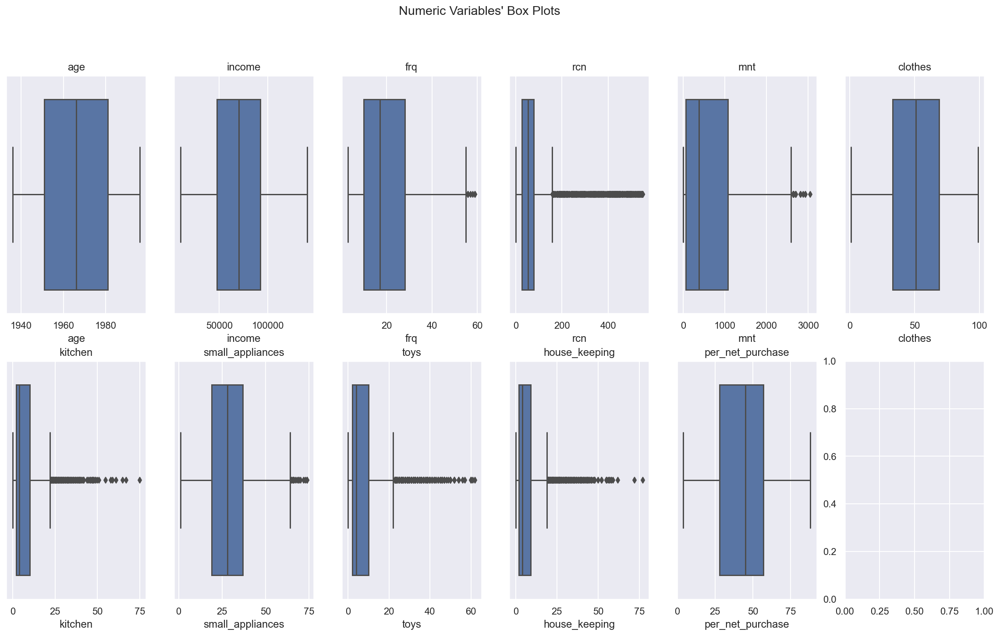

In [20]:
# All Numeric Variables' Histograms in one figure
sns.set()

plot_multiple_boxplots(df, metric_features)


### Insights:
- univariate distributions
- potential univariate outliers

--------------------------------------

### During our Exploratory Data Analysis (EDA), we must also account for:
- Coherence check
- Outliers
- Missing values
- Feature Engineering

--------------------------------------

### Depending on the context, various steps must be considered when performing Data Preprocessing. The most relevant steps are the following:
- Coherence check (find inconsistent values, missing values, outliers and any other problem you may find in your dataset)
- Data editing (fix inconsistent values)
- Data cleansing (drop observations - Outlier removal and removal of inconsistent values and/or features)
- Data wrangling (feature extraction/engineering and transformation)
- Data reduction (reducing the dimensionality of a dataset, producing summary statistics, reducing the number of records in a dataset)

## Pairwise Relationship of Numeric Variables

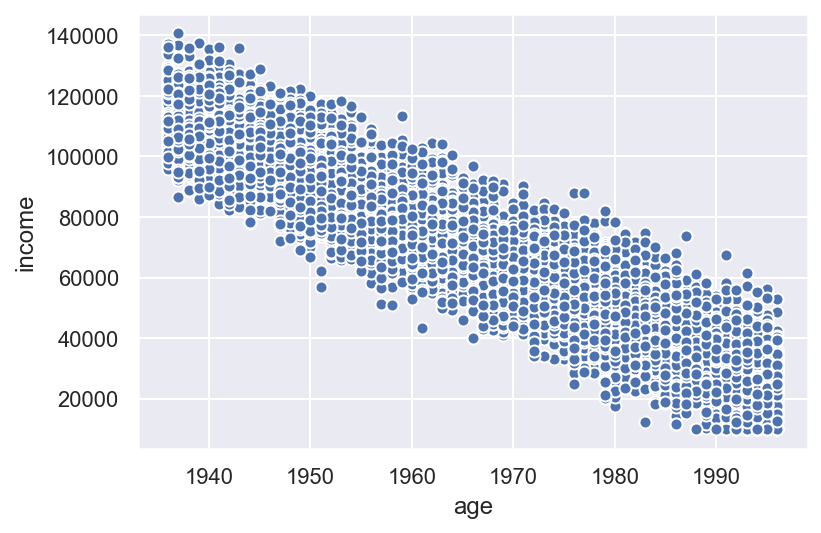

In [21]:
# Single Metric Variable Scatter plot
plt.scatter(df["age"], df["income"], edgecolors="white")
plt.xlabel("age")
plt.ylabel("income")

plt.show()

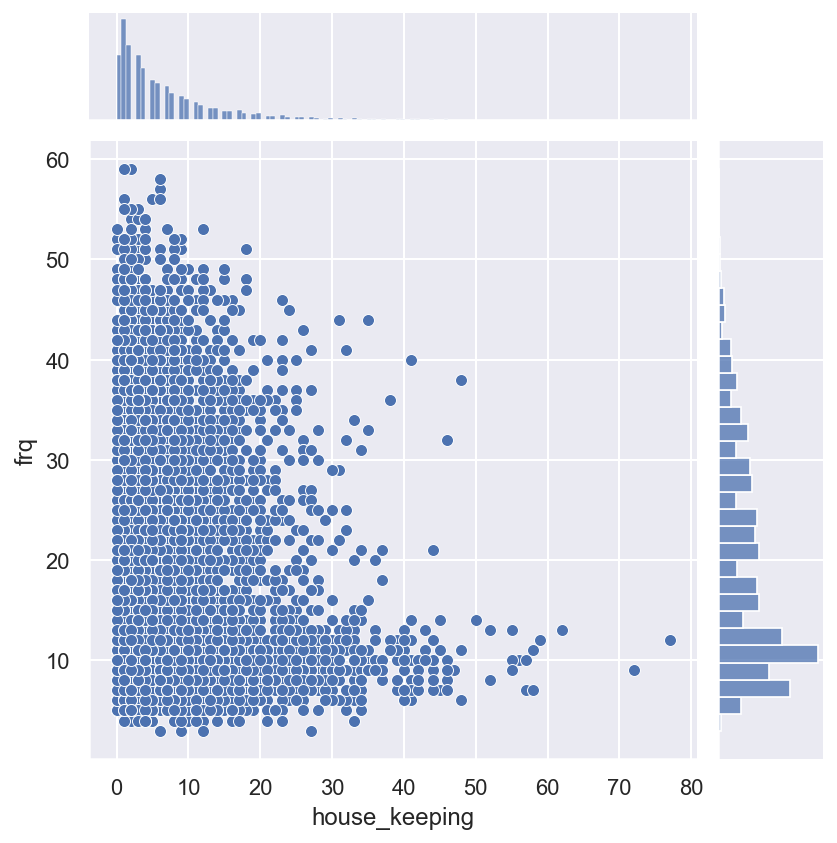

In [22]:
# making a joint plot with default formatting
sns.jointplot(data=df, x="house_keeping", y="frq")
plt.show()


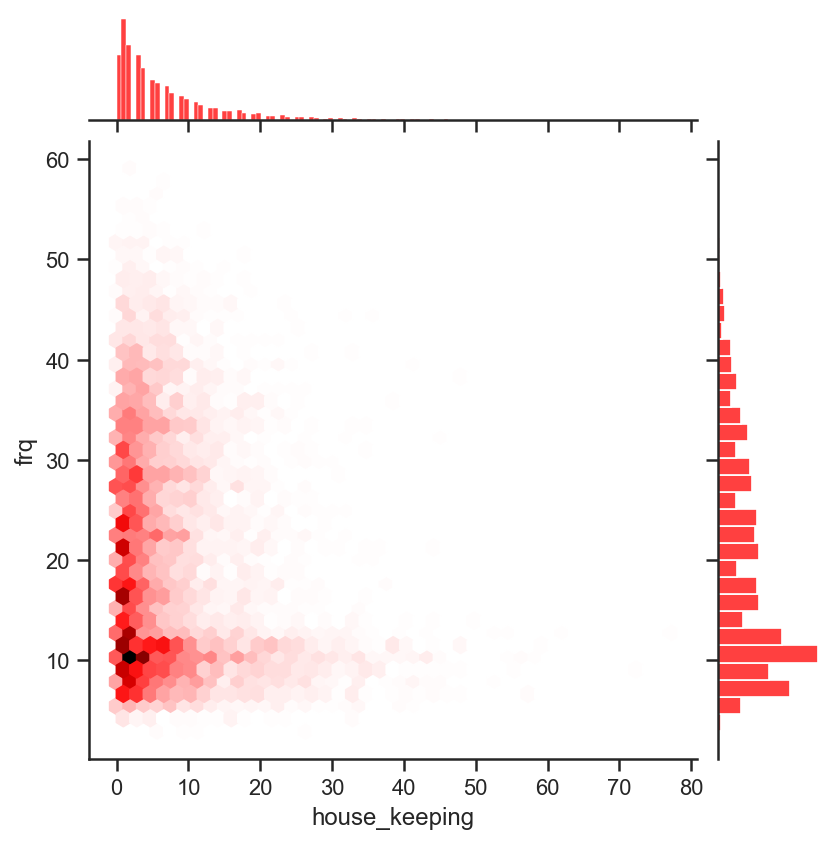

In [23]:
# Making the same visualization with customized formatting
sns.set(style="ticks")
sns.jointplot(data=df, x="house_keeping", y="frq", kind="hex", color="red")
plt.show()

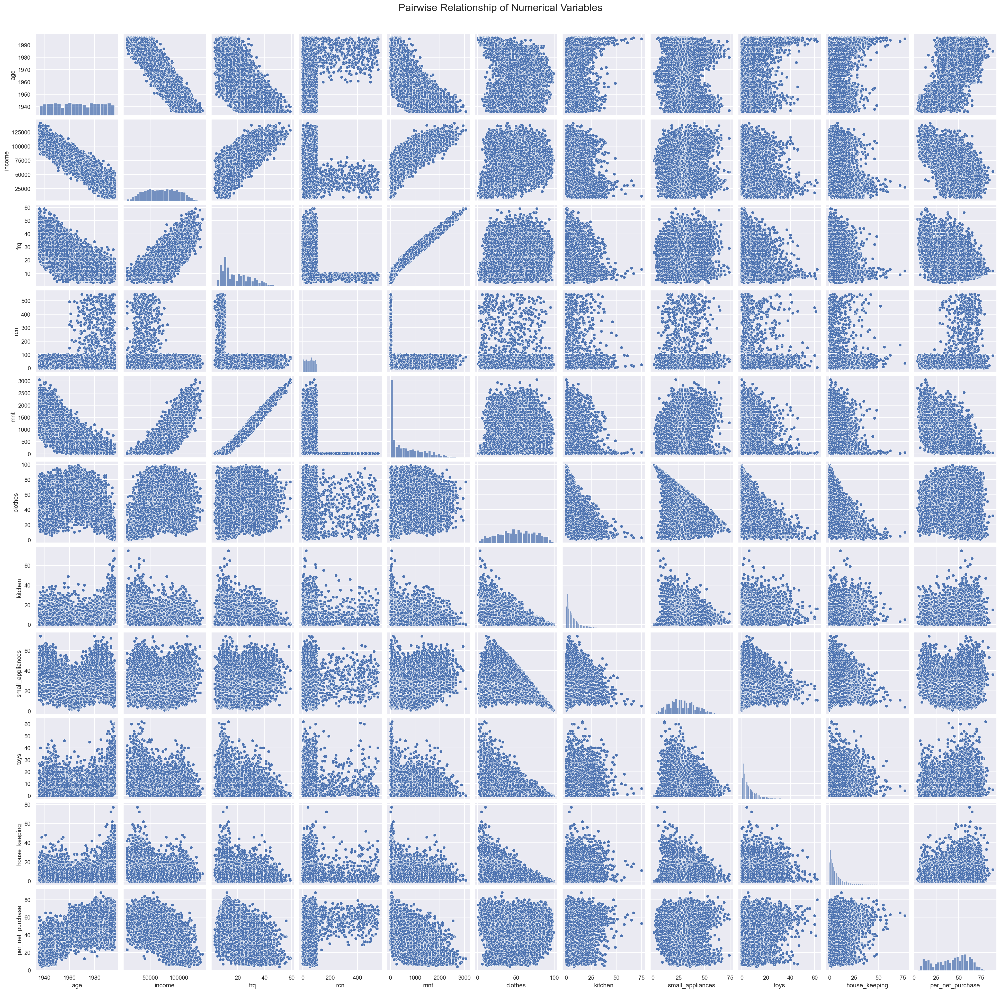

In [24]:
# Pairwise Relationship of All Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df[metric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

### Insights:
- possible bivariate relationships
- potential bivariate outliers
- univariate distributions (diagonal)

## Categorical Features Frequencies

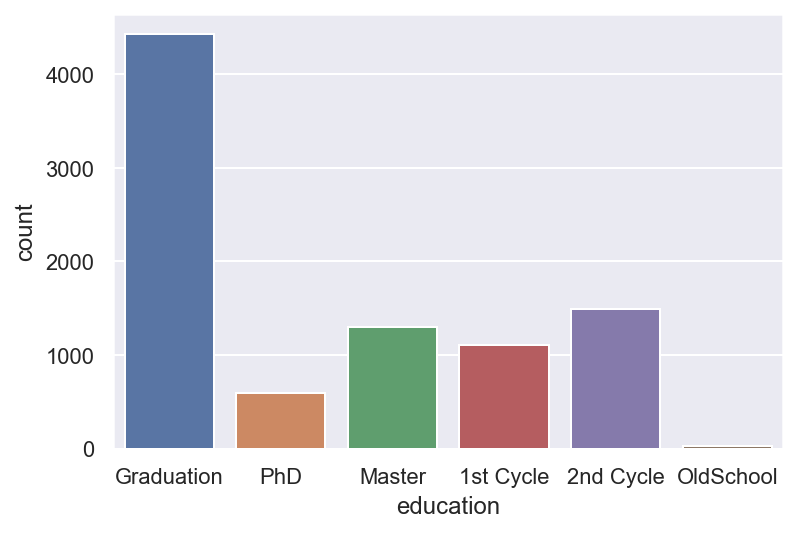

In [25]:
# Single Non-Metric variable bar plot
sns.set()
sns.countplot(x=df["education"])

plt.show()

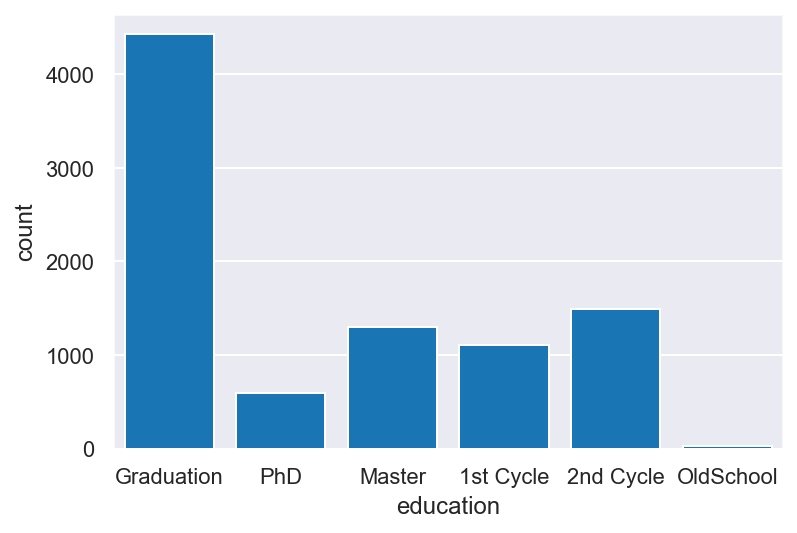

In [26]:
# Same plot, custom color used
sns.countplot(x=df["education"], color='#007acc')
plt.show()


In [27]:
## Define a function that plots multiple histograms

def plot_categorical_frequencies(data, feats, 
                             save_image=False, 
                             image_path="categorical_variables_histograms.png", 
                             title="Categorical Variables' Frequencies"):
  
  # Prepare figure. Create individual axes where each histogram will be placed
  fig, axes = plt.subplots(2, ceil(len(feats) / 2), figsize=(20, 11))

  # Plot data
  # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
  for ax, feat in zip(axes.flatten(), feats): # Notice the zip() function and flatten() method
      sns.countplot(x=df[feat].astype(object), ax=ax, color='#007acc')
      
  # Layout
  # Add a centered title to the figure:
  plt.suptitle(title)

  # Optionally save the image
  if save_image:
    plt.savefig(image_path)

  plt.show()

  return



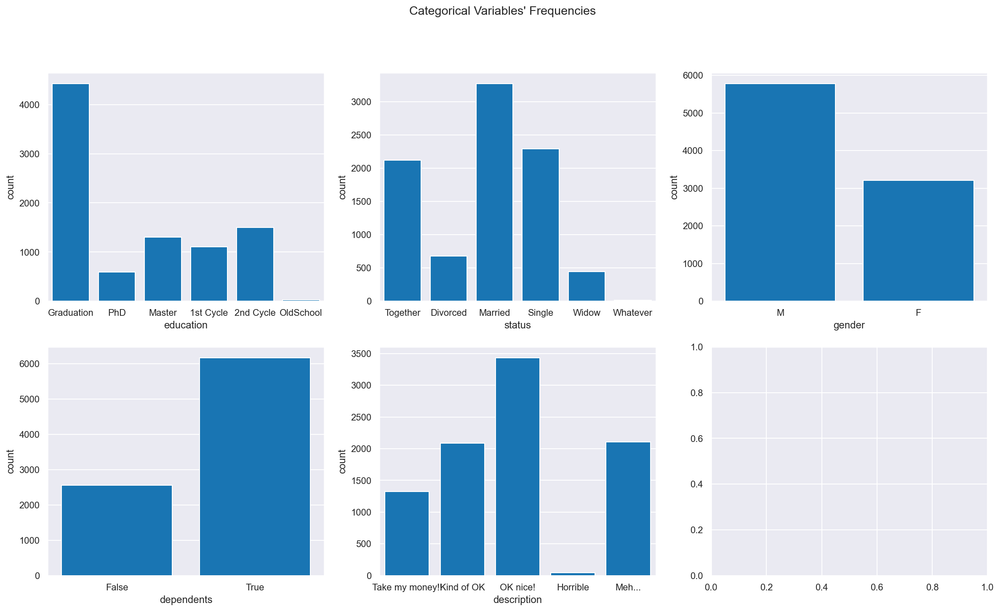

In [28]:
plot_categorical_frequencies(df, non_metric_features)

## Comparing Two Categorical Features

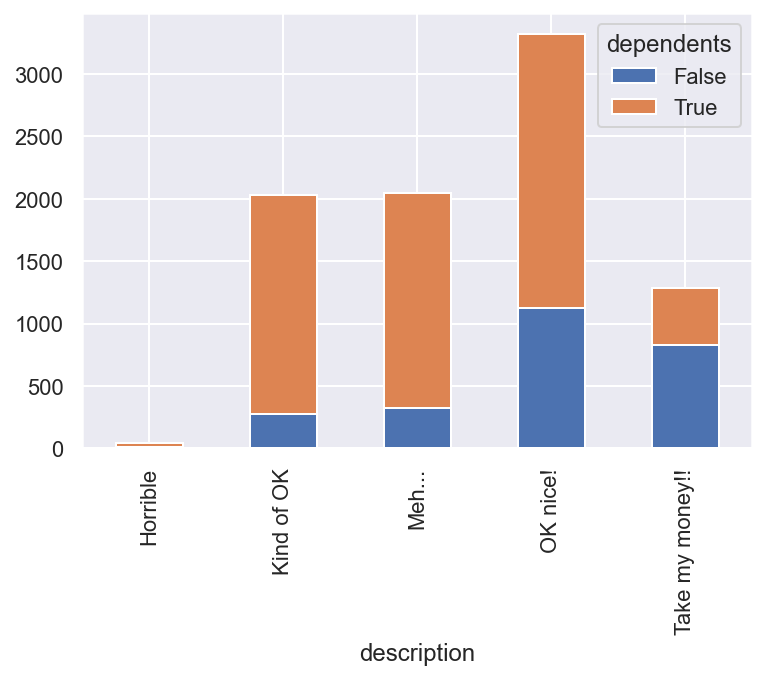

In [29]:
sns.set()
df_counts = df\
    .groupby(['description', 'dependents'])\
    .size()\
    .unstack()\
    .plot.bar(stacked=True)

## Comparing Categorical vs Continuous Variables

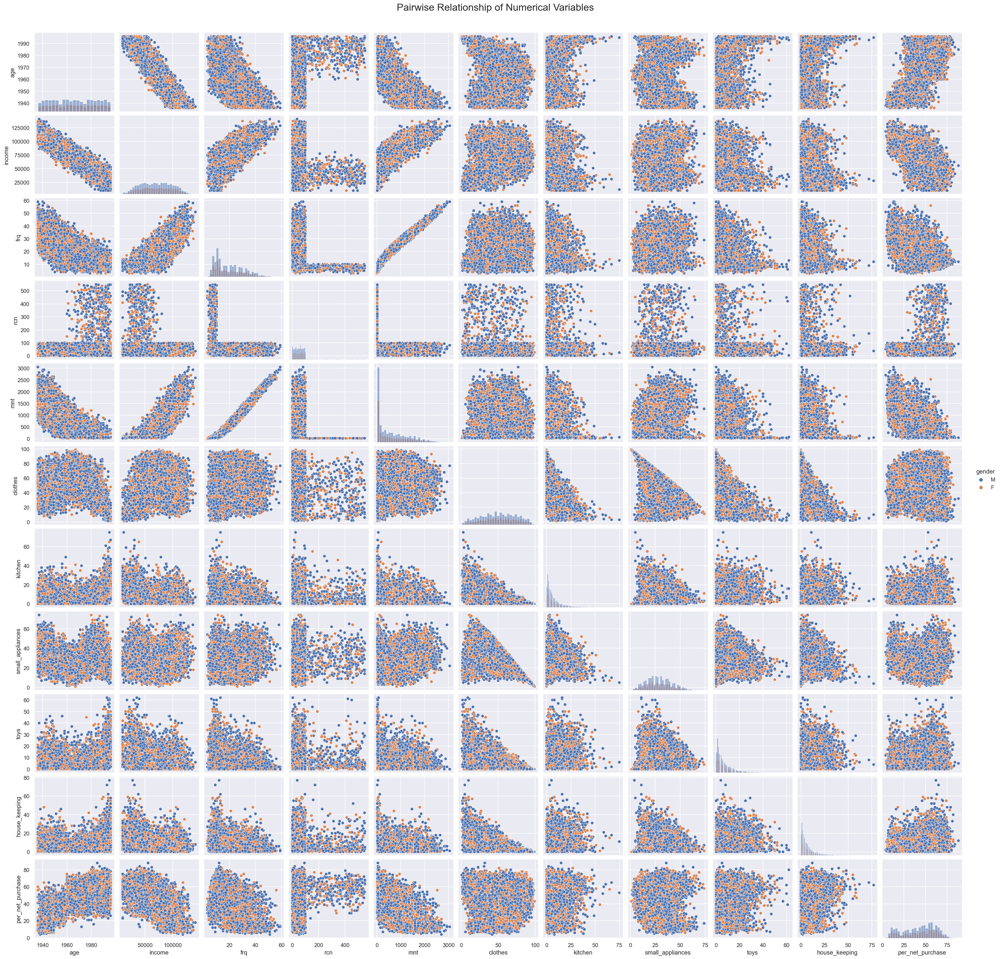

In [30]:
# Pairwise Relationship of Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df[metric_features + ['gender']], diag_kind="hist", hue='gender')

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

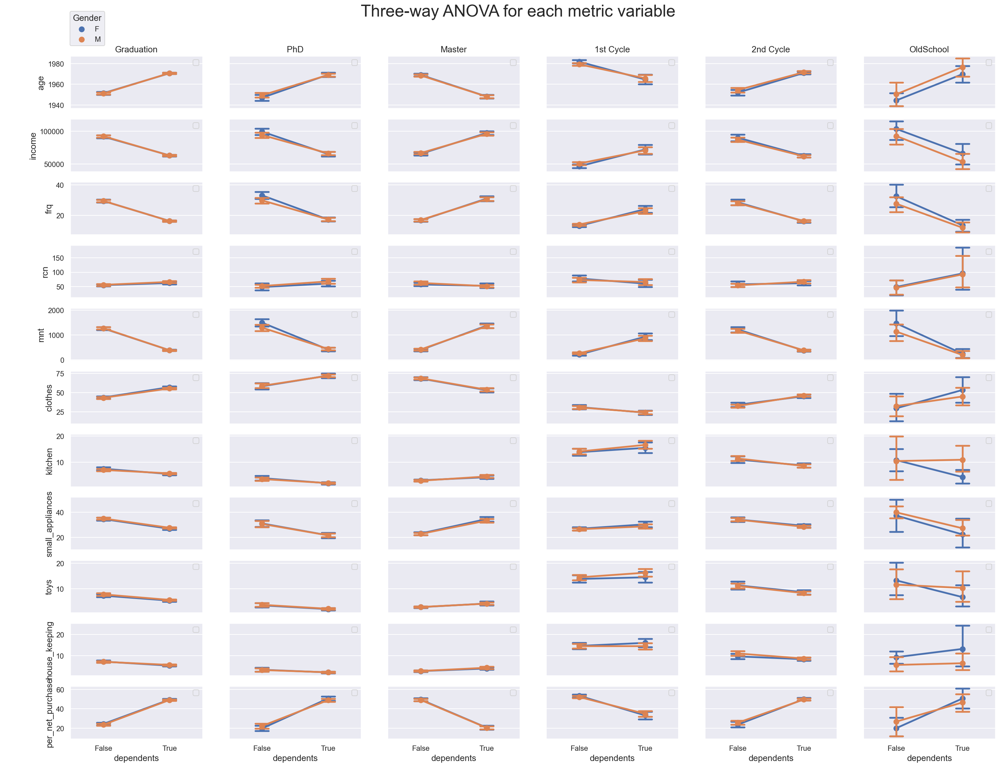

In [31]:
# notice we drop missing values in order to not plot it as a distinct value
educ_vals = df.education.dropna().unique()
educ_vals = educ_vals

fig, axes = plt.subplots(len(metric_features), len(educ_vals), figsize=(25,18), sharex=True, sharey="row")


for ax, (feat, educ_deg) in zip(axes.flatten(), product(metric_features, educ_vals)):
    # get the data for each subplot
    data = df.loc[df.education == educ_deg,:].copy()
    data['dependents'] = data['dependents'].astype(object)
    
    # we are distinguishing points according to the variable "dependents"
    sns.pointplot(x="dependents", y=feat, hue="gender", hue_order=["F", "M"], data=data, capsize=.2,
             height=6, aspect=.75, ax=ax)
    
    # remove the typical default y and x labels and legend of each axis
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.legend('')

# set columns' titles (education)
for ax, label in zip(axes[0,:], educ_vals):
    ax.set_title(label, fontsize=13)

# set metric names
for ax, label in zip(axes[:,0], metric_features):
    ax.set_ylabel(label, fontsize=13)

# set x axis label (dependents)
for ax in axes[-1,:]:
    ax.set_xlabel('dependents', fontsize=13)

# Set legend (gender)
handles, _ = axes[0,0].get_legend_handles_labels()
fig.legend(handles, ["F","M"], loc=(0.07,0.94), title="Gender", title_fontsize=13)

# set figure
plt.subplots_adjust(top=0.92)
plt.suptitle("Three-way ANOVA for each metric variable", fontsize=25)

plt.show()

## Metric Variables Correlation Matrix

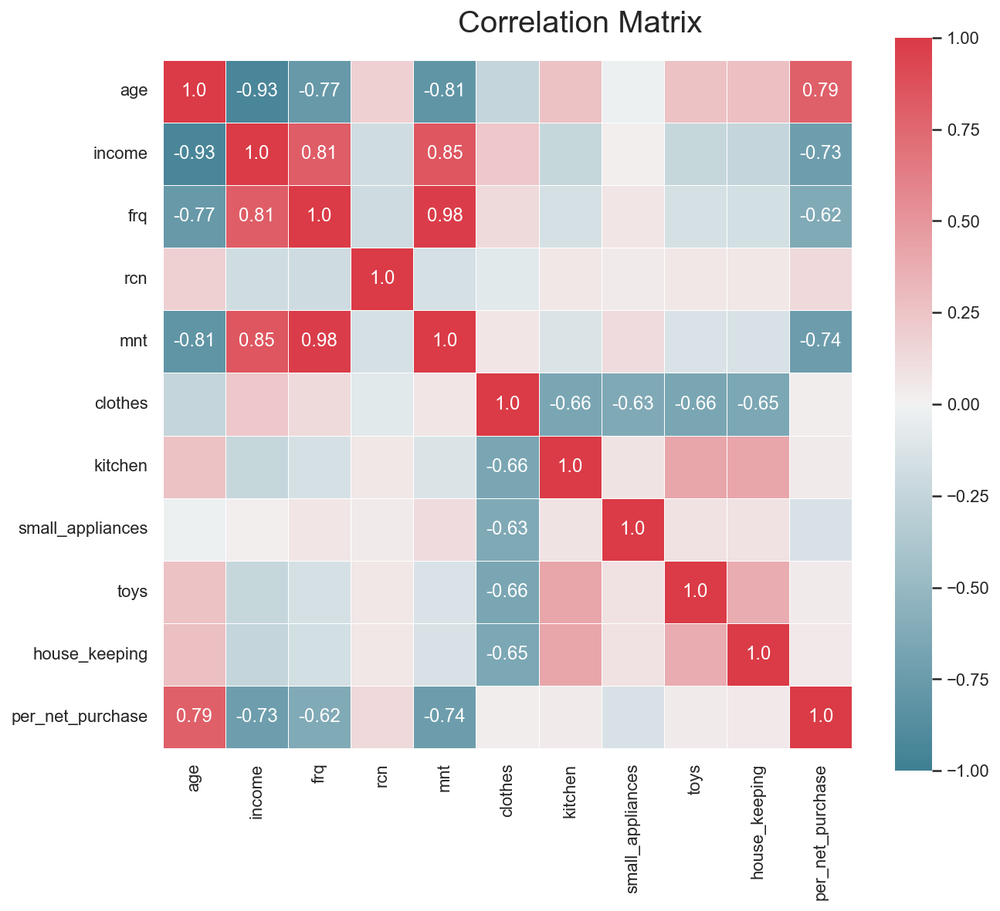

In [32]:
# Prepare figure
fig = plt.figure(figsize=(10, 8))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(df[metric_features].corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()


## Using `pandas-profiling`

## A tool to assist you through your exploratory data analysis

Optionally, you may use `pandas-profiling` as a first approach to your data analysis. Remember, although this tool provides excelent insights about the data you're working with, it is not enough to perform a proper analysis.

In [33]:
profile = ProfileReport(
    df, 
    title='Tugas Customer Data',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)

In [34]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]